In [1]:
%load_ext autoreload
%autoreload 2
import sys
import os

if not getattr(sys, "_src_path_added", False):
    src_path = os.path.abspath(os.path.join(os.getcwd(), ".."))
    if src_path not in sys.path:
        sys.path.insert(0, src_path)
    sys._src_path_added = True 

In [2]:
from MTGA.MTGA import *

from MTGA.MTGAInstance import Instance
import MTGA.Generators as Generators
import MTGA.Mutators as Mutators
import MTGA.WeightGenerators as WeightGenerators
import MTGA.GeneMutators as GeneMutators
import Fixers as Fixers
import Evaluators as Evaluators

from MTGA.GeneVisualizer import GeneEvolutionRenderer
from Displayer import Displayer

from Utils import *
from MTGA.MTGAUtils import *

## Main Instance

In [3]:
instance = Instance("../problems/p6.json",
    evaluator=Evaluators.CummulativeEvaluator(),
    mutator=Mutators.WalkMutator(),
    generator=Generators.TruncatedNormal(),
    fixer=Fixers.ChoiceFixer(),
    weight_generator=WeightGenerators.SoftmaxWeights(),
    gene_mutator=GeneMutators.Normal())

problem size 1300
fire starts [1]
num teams 3


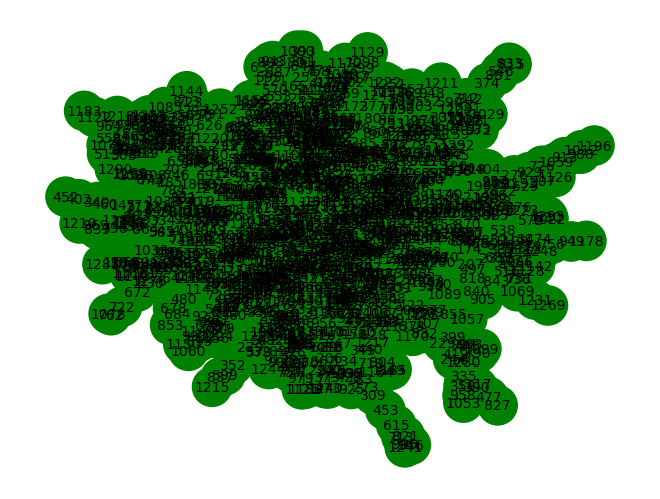

In [4]:
print("problem size", instance.size)
print("fire starts", instance.problem.fire_starts)
print("num teams", instance.problem.num_teams)
draw_graph(instance.problem)

In [5]:
displayer = Displayer()
gene_displayer = GeneEvolutionRenderer()

## The Run

In [6]:
data = optimize_and_collect(instance)

[2025-02-09 18:23:38][  0]     1.19033289     1.19025445 {7430.00000000 23476.56800000 255955.00000000 26052.77916187}
[2025-02-09 18:23:40][  1]     2.36329818     1.17021108 {7431.00000000 23661.50400000 235304.00000000 27232.22018863}
[2025-02-09 18:23:41][  2]     3.54541039     1.17730665 {7424.00000000 25730.98800000 281589.00000000 32306.49858329}
[2025-02-09 18:23:42][  3]     4.89350033     1.34509897 {7428.00000000 25911.08400000 259847.00000000 31321.68571308}
[2025-02-09 18:23:43][  4]     6.14725351     1.24341106 {7424.00000000 27504.92000000 243074.00000000 35804.39983261}
[2025-02-09 18:23:45][  5]     7.39991307     1.24991941 {7429.00000000 22776.79000000 206630.00000000 26698.53569861}
[2025-02-09 18:23:46][  6]     8.95454907     1.54950309 {7428.00000000 24835.54000000 275361.00000000 31079.57756258}
[2025-02-09 18:23:48][  7]    10.45615268     1.49924159 {7430.00000000 26502.40600000 306537.00000000 35057.34647034}
[2025-02-09 18:23:49][  8]    11.93532968     1.

In [7]:
solutions = correct_solutions(instance)

## Results

In [8]:
best_solution, best_solutions_value = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value}]:\n{best_solution}")

Best solution [317]:
[8, 13, 280]


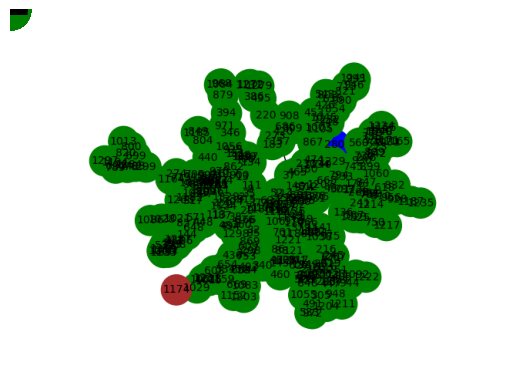

In [9]:
instance.problem.visualize_fire_without_burned(displayer, best_solution)

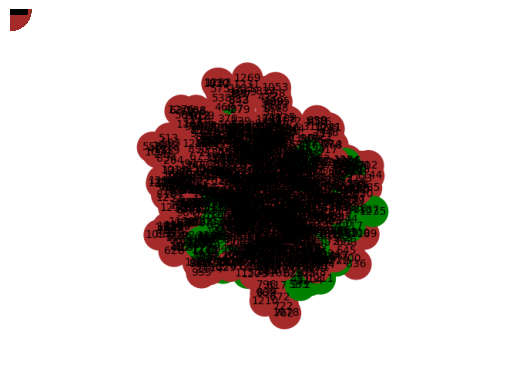

In [10]:
instance.problem.visualize_fires(displayer, solutions)

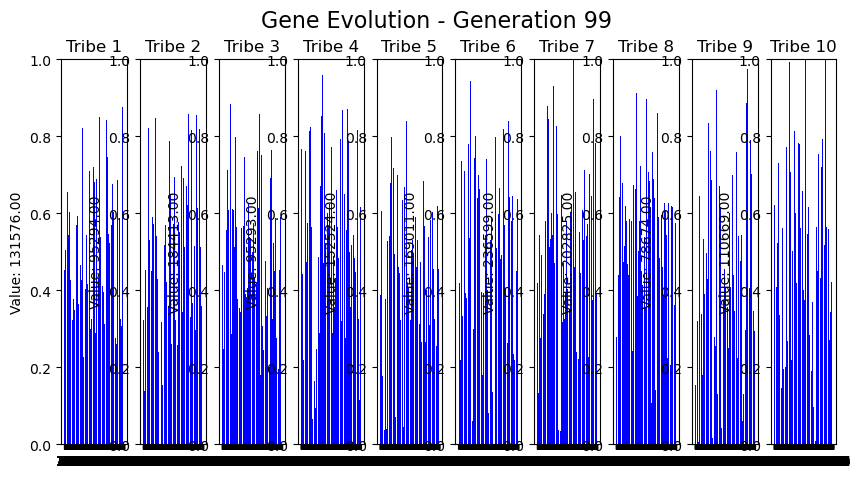

In [11]:
gene_displayer.visualize(data)

## Instance 200

In [ ]:
# data200, instance200 = collect_and_visualize("../problems/p6.json", local_step_size=0.03, sigma=0.04)

In [ ]:
# gene_displayer.visualize(data200)

In [ ]:
# solutions = correct_solutions(instance200)

In [ ]:
# best_solution_200, best_solutions_value_200 = max(solutions, key=lambda x: x[1])
# print(f"Best solution [{best_solutions_value_200}]:\n{best_solution_200}")